# Homework 3.2: Generative Adversarial Networks
---
Here, you will study one of the most popular approaches to generative modeling. We will consider a toy problem and a simplified model since state-of-the-art generative models take weeks to converge on multiple GPUs. This will make the final results not that impressive, but still instructive.

For this assignment, it is advised to use a **GPU** accelerator.

In [1]:
# Uncomment and run if in Colab
!mkdir datasets
!gdown --id 1LPYTu85QYYe_d1IS0l0v3fKzG3gjXrwC -O datasets/flowers-17.tar.gz
!tar -xzf datasets/flowers-17.tar.gz -C datasets
!rm datasets/flowers-17.tar.gz
!gdown --id 1kpL8fGK2AkgCJmMcWklIuP8A8B8xCAC2
!tar -xzf part2_gans.tar.gz
!rm part2_gans.tar.gz

!pip install pytorch_lightning
!pip install scipy

mkdir: cannot create directory ‘datasets’: File exists
Downloading...
From: https://drive.google.com/uc?id=1LPYTu85QYYe_d1IS0l0v3fKzG3gjXrwC
To: /content/datasets/flowers-17.tar.gz
100% 1.71M/1.71M [00:00<00:00, 55.0MB/s]
Downloading...
From: https://drive.google.com/uc?id=1kpL8fGK2AkgCJmMcWklIuP8A8B8xCAC2
To: /content/part2_gans.tar.gz
100% 410k/410k [00:00<00:00, 55.0MB/s]


## Datasets

We will use a pre-processed [17 category Flowers dataset](https://www.robots.ox.ac.uk/~vgg/data/flowers/17/). Below are few samples of the original images. We will use a processed version: images that are center square cropped and resized to 64 pixels.

<img src="https://i.imgur.com/OYQd8JY.jpg"/>

## Assignments and grading


- **Part 1. Code**: fill in the empty gaps (marked with `#TODO`) in the code of the assignment (36 points):
    - `model.py` -- 26 points
    - `loss.py` -- 8 points
    - `train.py` -- 2 points
- **Part 2. Train and benchmark** the performance of the required models (6 points):
    - All 3 checkpoints are provided -- 3 points
    - All 4 variants are evaluated -- 2 points
- **Part 3. Report** your findings (9 points)
    - Each task -- 3 points

- **Total score**: 50 points.

The grading policy is the same as in the semantic segmentation part. It is provided below:

For detailed grading of each coding assignment, please refer to the comments inside the files. Please use the materials provided during a seminar and during a lecture to do a coding part, as this will help you to further familiarize yourself with PyTorch. Copy-pasting the code from Google Search will get penalized.

In part 2, you should upload all your pre-trained checkpoints to your personal Google Drive, grant public access and provide a file ID, following the intructions in the notebook.

Note that for each task in part 3 to count towards your final grade, you should complete the corresponding tasks in part 2.

For example, if you are asked to compare Model X and Model Y, you should provide the checkpoints for these models in your submission trained for the required number of epochs.

## Part 1. Code

### `model.py`
**TODO: implement generator and discriminator models.**

We will use DCGAN architecture as a base, but with a few key modifications which significantly improve the quality of the results.

<img src="https://i.imgur.com/h4ubSt9.png"/>

#### 1. Each block is a pre-activation residual block.

<img src="https://i.imgur.com/CqQM9mO.jpg"/>

It has a much better gradient flow compared to the standard residual block and is now fairly common in generative models. If needed, upsampling is performed at the start of the block (before branching), and downsampling is performed at the end (after residual sum).

#### 2. We conditon on the noise vector multiple times throughout the network.

One of the most popular ways of doing that is via adaptive batch normalization:

$$
    x = \frac{ x - \mu }{ \sigma } \gamma + \beta,\quad \gamma = f(z),\ \beta = g(z)
$$

The first part of this operation is a standard batch normalization, but instead of optimizing $\gamma$ and $\beta$ as a vector, we optimize functions $f$ and $g$, which predict affine parameters from a noise vector $z$. Typically these functions are simple linear mappings.

#### 3. We condition both generation and discrimination on classes.

If our data is labeled with classes, we can use these to boost the performance of our GANs. The conditioning of the generator is straightforward: we simply train embeddings for each available class, and concatenate them with noise to use as inputs to the network and its adaptive batch normalization layers:

<img src="https://i.imgur.com/VFiaU6N.jpg"/>

Therefore, our model produces its outputs using not only the noise vector $z$ but also on a class $k$, for each of which we train an embedding vector $c_k$.

For the discriminator, one of the most popular ways of conditioning on a class label is by using the so-called "projection":

<img src="https://i.imgur.com/jCwkb5R.png"/>

In this scheme, $\phi$ denotes a convolutional part of the discriminator, which outputs a vector; $\psi$ is a linear layer with maps a vector into a single digit; $y$ is a trainable class embedding. The output of this projection layer is fed into an adversarial loss. This layer allows the discriminator to learn whether or not a synthesized image belongs to the class which we input into the generator.

To sum up, generator class embeddings $c$ and discriminator embeddings $y$ are vectors from trainable matrices of the shape $\text{number of classes} \times \text{dimensionality of the embeddings}$, corresponding to the class $k$ which we condition our sample on. In our case, these matrices will be different for generator and discriminator and will have different embedding dimensionalities.

### `loss.py`
**TODO: implement train and validation losses.**

#### Training

There are multiple ways to train generative adversarial networks. We will try out 3 of them, which historically preceded each other.

#### 1. Non-saturating GAN

$$
    \mathcal{L}_D = - \mathbb{E}_{x\sim p_\text{real}} [ \log D(x) ] - \mathbb{E}_{z\sim \mathcal{N}(0, \mathbb{I})} [ \log(1 - D(G(z)) ]
$$

$$
    \mathcal{L}_G = - \mathbb{E}_{z\sim \mathcal{N}(0, \mathbb{I})} [\log D(G(z))]
$$

It corresponds to using a standard binary cross-entropy loss for $D$, and BCE with fake data treated as real data for $G$.

#### 2. Hinge Loss GAN

$$
    \mathcal{L}_D = -\mathbb{E}_{x\sim p_\text{real}} \big[ \min\big(0, -1 + D(x) \big) \big] - \mathbb{E}_{z\sim \mathcal{N}(0, \mathbb{I})} \big[ \min\big(0, -1 - D(G(z)) \big) \big]
$$

$$
    \mathcal{L}_G = - \mathbb{E}_{z\sim \mathcal{N}(0, \mathbb{I})} D(G(z))
$$

This objective is derived from a hinge loss (used, for example, as an objective in SVMs). Arguably, it has the best gradient flow, and now it a go-to objective for GAN training.

#### Validation

For validation, we will use two main metrics: **Frechet Inception Distance (FID)** and **Inception Score (IS)**.

They are both calculated using the outputs of an **Inception v3** network (hence "inception" in their names), although any other pre-trained classification network can also be used in the same way to obtain similar metrics.

#### 1. Frechet Inception Distance

This metric is calculated using a feature vector right after global average pooling before the final classification head. The feature vector can be treated as a multi-dimensional random variable with some distribution. This distribution will be different, if we evaluate these features using real images from the dataset, or images generated using our generative models. The general idea behind **FID** is to try and approximate the difference between these two distributions and use it as a quality metric (the lower it is, the better).

To do that, we approximate these two distribution using a multivariate gaussian distribution. To do that, we need to calculate the mean vector $\mu$ and a covariance matrix $\Sigma$ using either samples from the dataset: $\mu_r$, $\Sigma_r$, or generated samples: $\mu_g$, $\Sigma_g$. Note that these are full covariance matrices.

Then, **FID** can be calculated using KL divergence between these two distributions:

$$
    \text{FID} = ||\mu_r - \mu_g||^2 + \text{tr}\,\big(\Sigma_r + \Sigma_g - 2(\Sigma_r \Sigma_g)^{1/2}\big)
$$

#### 2. Inception Score

For this metric, we will need the outputs of the classification head, which we should convert to class probabilities via a softmax. 

To calculate it, we will only use generated data, and try to evaluate two qualities: their "objectiveness", and the diversity.

For the "objectiveness" metric, we can look at the distribution of the class probabilities and check whether or not it has a pike. Here, we assume that outputs of our generative models should represent objects, which have a structure, similar to an ImageNet dataset. This would be a bad assumption if we generate X-ray or other medical images, but it's actually fairly true for natural images, thanks to the diversity of ImageNet. If our model generates a smeared blob of artifacts, it is unlikely to be classified as some object by an ImageNet classifier.

A good measure to determine if the distribution is "piky" is entropy. It is the lowest if predicted probability is a one-hot vector, and highest if it is uniform accross all calsses.

For "diversity", we are going to use the same idea: our samples are diverse, if their averaged class probability distribution is uniform.

Combining these two measurements, we can come up with the following objective:

$$
    \text{IS} = \exp \Bigg[ \mathbb{E}_{\hat{x}\sim p(\hat{x})}\ \text{KL} \big( p(y \mid \hat{x})\ \big\|\ p(y) \big) \Bigg] = \exp \Bigg[ \mathbb{E}_{\hat{x}\sim p(\hat{x})} \sum_{k=1}^{K}\ p(y_k \mid \hat{x}) \log \bigg[ \frac{ p(y_k \mid \hat{x} ) }{ p(y_k) } \bigg] \Bigg]
$$

where $K = 1000$ for ImageNet-pretrained networks.

For more details about derivation and applicability, you can refer to this [link](https://medium.com/octavian-ai/a-simple-explanation-of-the-inception-score-372dff6a8c7a).

### `train.py`

Here you will need to write a training step for GANs (alternating gradients descend, where we first update the generator, and thenn a discriminator), and also implement a neat feature called "truncation trick".

There are multiple ways to improve test-time performance of trained GANs (i.e., obtain better samples). Some are more complicated, like [usage of Langevin dynamics](https://arxiv.org/abs/2003.06060) for sampling, some are much simpler, like [rejection sampling](https://arxiv.org/abs/1810.06758). We will consider the simplest, yet one of the most effective and universally used approaches: [truncation trick](https://paperswithcode.com/method/truncation-trick).

The idea is based on an observation that if, instead of $\mathcal{N}(0, \mathbb{I})$, we sample from a truncated normal distribution, the results that we get will have a better visual quality. You will have to implement sampling from a truncated normal distribution and use it during evaluation.

## Part 2. Train and evaluate

You will have to train and evaluate the following variants for the generative model:

1. Non-class conditional setting: non-saturating GAN and hinge Loss GAN
2. Class conditional hinge loss GAN
3. Evaluate class conditional hinge loss GAN with truncation trick

For training, use the code example below, with the provided number of epochs. For evaluation use `GANValLoss` class that you have implemented. You need to obtain **FID** and **IS** values for all the 4 required experiments.

In [2]:
import torch
from torch import nn
from torch.nn import functional as F
import functools
import math
from torch.nn.utils import spectral_norm

class AdaptiveBatchNorm(nn.BatchNorm2d):
    """
    Adaptive batch normalization layer (4 points)

    Args:
        num_features: number of features in batch normalization layer
        embed_features: number of features in embeddings

    The base layer (BatchNorm2d) is applied to "inputs" with affine = False

    After that, the "embeds" are linearly mapped to "gamma" and "bias"
    
    These "gamma" and "bias" are applied to the outputs like in batch normalization
    with affine = True (see definition of batch normalization for reference)
    """
    def __init__(self, num_features: int, embed_features: int):
        super(AdaptiveBatchNorm, self).__init__(num_features, affine=False)
        # TODO
        self.lin1 = nn.Linear(embed_features, num_features)
        self.lin2 = nn.Linear(embed_features, num_features)

    def forward(self, inputs, embeds):
        gamma = self.lin1(embeds) # TODO 
        bias = self.lin2(embeds) # TODO

        assert gamma.shape[0] == inputs.shape[0] and gamma.shape[1] == inputs.shape[1]

        outputs = super().forward(inputs) # TODO: apply batchnorm

        return outputs * gamma[..., None, None] + bias[..., None, None]


class PreActResBlock(nn.Module):
    """
    Pre-activation residual block (6 points)

    Paper: https://arxiv.org/pdf/1603.05027.pdf
    Scheme: materials/preactresblock.png
    Review: https://towardsdatascience.com/resnet-with-identity-mapping-over-1000-layers-reached-image-classification-bb50a42af03e

    Args:
        in_channels: input number of channels
        out_channels: output number of channels
        batchnorm: this block is with/without adaptive batch normalization
        upsample: use nearest neighbours upsampling at the beginning
        downsample: use average pooling after the end

    in_channels != out_channels:
        - first conv: in_channels -> out_channels
        - second conv: out_channels -> out_channels
        - use 1x1 conv in skip connection

    in_channels == out_channels: skip connection is without a conv
    """
    def __init__(self,
                 in_channels: int,
                 out_channels: int,
                 embed_channels: int = None,
                 batchnorm: bool = False,
                 upsample: bool = False,
                 downsample: bool = False):
        super(PreActResBlock, self).__init__()
        # TODO: define pre-activation residual block
        # TODO: apply spectral normalization to conv layers
        # Don't forget that activation after residual sum cannot be inplace!
        self.batchnorm = batchnorm
        self.upsample = upsample
        self.downsample = downsample

        if self.upsample:
            self.up = nn.UpsamplingNearest2d(scale_factor=2)

        if self.downsample:
            self.down = nn.AvgPool2d(kernel_size=2)

        self.skip_connection = torch.nn.utils.spectral_norm(nn.Conv2d(in_channels, out_channels, 1))

        if self.batchnorm:
            self.ad_norm1 = AdaptiveBatchNorm(in_channels, embed_channels)
        else:
            self.ad_norm1 = nn.Identity()
        self.relu1 = nn.ReLU()
        self.sp_norm_conv1 = spectral_norm(nn.Conv2d(in_channels, out_channels, 3, padding=1))
        
        if self.batchnorm:
            self.ad_norm2 = AdaptiveBatchNorm(out_channels, embed_channels)
        else:
            self.ad_norm2 = nn.Identity()        
        self.relu2 = nn.ReLU()
        self.sp_norm_conv2 = spectral_norm(nn.Conv2d(out_channels, out_channels, 3, padding=1))

    def forward(self, 
                inputs, # regular features 
                embeds=None): # embeds used in adaptive batch norm
        # TODO
        if self.upsample:
            inputs = self.up(inputs)

        if self.batchnorm: 
            outputs = self.ad_norm1(inputs, embeds)
        else:
            outputs = self.ad_norm1(inputs)

        outputs = self.sp_norm_conv1(self.relu1(outputs))
        if self.batchnorm:
            outputs = self.ad_norm2(outputs, embeds)
        else:
            outputs = self.ad_norm2(outputs)

        outputs = self.sp_norm_conv2(self.relu2(outputs))

        # skip connection
        outputs += self.skip_connection(inputs)

        if self.downsample:
            outputs = self.down(outputs)

        return outputs

class Generator(nn.Module):
    """
    Generator network (8 points)
    
    TODO:

      - Implement an option to condition the synthesis on trainable class embeddings
        (use nn.Embedding module with noise_channels as the size of each embed)

      - Concatenate input noise with class embeddings (if use_class_condition = True) to obtain input embeddings

      - Linearly map input embeddings into input tensor with the following dims: max_channels x 4 x 4

      - Forward an input tensor through a convolutional part, 
        which consists of num_blocks PreActResBlocks and performs upsampling by a factor of 2 in each block

      - Each PreActResBlock is additionally conditioned on the input embeddings (via adaptive batch normalization)

      - At the end of the convolutional part apply regular BN, ReLU and Conv as an image prediction head

      - Apply spectral norm to all conv and linear layers (not the embedding layer)

      - Use Sigmoid at the end to map the outputs into an image

    Notes:

      - The last convolutional layer should map min_channels to 3. With each upsampling you should decrease
        the number of channels by a factor of 2

      - Class embeddings are only used and trained if use_class_condition = True
    """    
    def __init__(self, 
                 min_channels: int, 
                 max_channels: int,
                 noise_channels: int,
                 num_classes: int,
                 num_blocks: int,
                 use_class_condition: bool):
        super(Generator, self).__init__()
        self.output_size = 4 * 2**num_blocks
        # TODO
        self.max_channels = max_channels
        self.use_class_condition = use_class_condition

        self.embed = torch.nn.Embedding(num_classes, noise_channels)

        if self.use_class_condition:
            noise_channels = noise_channels*2

        self.sp_norm_lin = torch.nn.utils.spectral_norm(nn.Linear(noise_channels, 4*4*self.max_channels))

        self.parb1 = PreActResBlock(self.max_channels, self.max_channels // 2, embed_channels=noise_channels, batchnorm=self.use_class_condition, upsample=True)
        self.parb2 = PreActResBlock(self.max_channels // 2, self.max_channels // 4, embed_channels=noise_channels, batchnorm=self.use_class_condition, upsample=True)
        self.parb3 = PreActResBlock(self.max_channels // 4, self.max_channels // 8, embed_channels=noise_channels, batchnorm=self.use_class_condition, upsample=True)
        self.parb4 = PreActResBlock(self.max_channels // 8, self.max_channels // 16, embed_channels=noise_channels, batchnorm=self.use_class_condition, upsample=True)
        
        self.head = nn.Sequential(
            nn.BatchNorm2d(min_channels),
            nn.ReLU(),
            torch.nn.utils.spectral_norm(nn.Conv2d(min_channels, 3, 3, padding=1)),
            nn.Sigmoid()
        )

    def forward(self, noise, labels):
        # TODO
        if self.use_class_condition: 
            noise = torch.cat((self.embed(labels), noise), dim=-1)  

        outputs = self.sp_norm_lin(noise).view(-1, self.max_channels, 4, 4)
        outputs = self.parb1(outputs, noise)
        outputs = self.parb2(outputs, noise)
        outputs = self.parb3(outputs, noise)
        outputs = self.parb4(outputs, noise)
            
        outputs = self.head(outputs)

        assert outputs.shape == (noise.shape[0], 3, self.output_size, self.output_size)
        return outputs

class Discriminator(nn.Module):
    """
    Discriminator network (8 points)

    TODO:
    
      - Define a convolutional part of the discriminator similarly to
        the generator blocks, but in the inverse order, with downsampling, and
        without batch normalization
    
      - At the end of the convolutional part apply ReLU and sum pooling
    
    TODO: implement projection discriminator head (https://arxiv.org/abs/1802.05637)
    
    Scheme: materials/prgan.png
    
    Notation:
    
      - phi is a convolutional part of the discriminator
    
      - psi is a vector
    
      - y is a class embedding
    
    Class embeddings matrix is similar to the generator, shape: num_classes x max_channels

    Discriminator outputs a B x 1 matrix of realism scores

    Apply spectral norm for all layers (conv, linear, embedding)
    """
    def __init__(self, 
                 min_channels: int, 
                 max_channels: int,
                 num_classes: int,
                 num_blocks: int,
                 use_projection_head: bool):
        super(Discriminator, self).__init__()
        # TODO
        self.use_projection_head = use_projection_head

        self.head = nn.Sequential(
            spectral_norm(nn.Conv2d(3, min_channels, 3, padding=1)), 
            nn.ReLU(),
            nn.BatchNorm2d(min_channels)
        )
        
        self.parb1 = PreActResBlock(min_channels, min_channels * 2, downsample=True)
        self.parb2 = PreActResBlock(min_channels * 2, min_channels * 4, downsample=True)
        self.parb3 = PreActResBlock(min_channels * 4, min_channels * 8, downsample=True)
        self.parb4 = PreActResBlock(min_channels * 8, min_channels * 16, downsample=True)
        
        self.sp_norm_embed = torch.nn.utils.spectral_norm(nn.Embedding(max_channels, 1))
        self.sp_norm_lin = torch.nn.utils.spectral_norm(nn.Linear(max_channels, 1))
        
        self.relu = nn.ReLU()

    def forward(self, inputs, labels):
        # TODO
        outputs = self.head(inputs)
        
        outputs = self.parb1(outputs)
        outputs = self.parb2(outputs)
        outputs = self.parb3(outputs)
        outputs = torch.sum(self.relu(self.parb4(outputs)), dim=(2, 3))

        scores = self.sp_norm_lin(outputs) # TODO
        
        if self.use_projection_head:
            scores = scores + torch.sum(torch.mul(self.sp_norm_embed(labels), scores), dim=1, keepdim=True)
        
        scores = scores.view((inputs.shape[0],))

        assert scores.shape == (inputs.shape[0],)
        return scores

In [3]:
# loss.py

import torch
from torch import nn
from torch.nn import functional as F
from torchvision import models
import numpy as np
from scipy import linalg

class GANLoss(nn.Module):
    """
    GAN loss calculator

    Variants:
      - non_saturating
      - hinge
    """
    def __init__(self, loss_type):
        super(GANLoss, self).__init__()
        self.loss_type = loss_type

    def forward(self, fake_scores, real_scores=None):
        EPS = 10e-9
        if real_scores is None:
            # TODO: calculate generator loss (2 points)
            if self.loss_type == 'non_saturating':
                loss = -torch.mean(torch.log(torch.sigmoid(fake_scores) + EPS), dim=0)
            if self.loss_type == 'hinge':
                loss = -torch.mean(fake_scores, dim=0)

        else:
            # TODO: calculate discriminator loss (2 points)
            if self.loss_type == 'non_saturating':
                loss = -torch.mean(torch.log(torch.sigmoid(real_scores) + EPS), dim=0) - torch.mean(torch.log(1.0 - torch.sigmoid(fake_scores) + EPS), dim=0)
            if self.loss_type == 'hinge':
                loss = -torch.mean(torch.minimum(torch.zeros_like(real_scores), -torch.ones_like(real_scores) + real_scores), dim=0) \
                - torch.mean(torch.minimum(torch.zeros_like(fake_scores), -torch.ones_like(fake_scores) - fake_scores), dim=0)

        return loss


class ValLoss(nn.Module):
    """
    Calculates FID and IS
    """
    def __init__(self):
        super(ValLoss, self).__init__()
        self.inception_v3 = models.inception_v3(pretrained=True)
        self.inception_v3.eval()

        for p in self.inception_v3.parameters():
            p.requires_grad = False

    @torch.no_grad()
    def _features(self, x: torch.Tensor) -> torch.Tensor:
        # Preprocess data
        x = F.interpolate(x, size=(299, 299), mode='bilinear')
        x = (x - 0.5) * 2

        # N x 3 x 299 x 299
        x = self.inception_v3.Conv2d_1a_3x3(x)
        # N x 32 x 149 x 149
        x = self.inception_v3.Conv2d_2a_3x3(x)
        # N x 32 x 147 x 147
        x = self.inception_v3.Conv2d_2b_3x3(x)
        # N x 64 x 147 x 147
        x = self.inception_v3.maxpool1(x)
        # N x 64 x 73 x 73
        x = self.inception_v3.Conv2d_3b_1x1(x)
        # N x 80 x 73 x 73
        x = self.inception_v3.Conv2d_4a_3x3(x)
        # N x 192 x 71 x 71
        x = self.inception_v3.maxpool2(x)
        # N x 192 x 35 x 35
        x = self.inception_v3.Mixed_5b(x)
        # N x 256 x 35 x 35
        x = self.inception_v3.Mixed_5c(x)
        # N x 288 x 35 x 35
        x = self.inception_v3.Mixed_5d(x)
        # N x 288 x 35 x 35
        x = self.inception_v3.Mixed_6a(x)
        # N x 768 x 17 x 17
        x = self.inception_v3.Mixed_6b(x)
        # N x 768 x 17 x 17
        x = self.inception_v3.Mixed_6c(x)
        # N x 768 x 17 x 17
        x = self.inception_v3.Mixed_6d(x)
        # N x 768 x 17 x 17
        x = self.inception_v3.Mixed_6e(x)
        # N x 768 x 17 x 17
        x = self.inception_v3.Mixed_7a(x)
        # N x 1280 x 8 x 8
        x = self.inception_v3.Mixed_7b(x)
        # N x 2048 x 8 x 8
        x = self.inception_v3.Mixed_7c(x)
        # Adaptive average pooling
        x = self.inception_v3.avgpool(x)
        # N x 2048 x 1 x 1
        x = self.inception_v3.dropout(x)
        # N x 2048 x 1 x 1
        x = torch.flatten(x, 1)

        return x

    @torch.no_grad()
    def _classifier(self, x: torch.Tensor) -> torch.Tensor:
        # N x 2048
        x = self.inception_v3.fc(x)
        # N x 1000 (num_classes)
        x = F.softmax(x, dim=1)

        return x

    def calc_data(self, real_inputs: list, fake_inputs: list):
        real_features = []
        for real_inputs_batch in real_inputs:
            real_features_batch = self._features(real_inputs_batch)
            real_features.append(real_features_batch.detach().cpu().numpy())            
        real_features = np.concatenate(real_features)

        fake_features = []
        fake_probs = []

        for fake_inputs_batch in fake_inputs:
            fake_features_batch = self._features(fake_inputs_batch)
            fake_probs_batch = self._classifier(fake_features_batch)

            fake_features.append(fake_features_batch.detach().cpu().numpy())
            fake_probs.append(fake_probs_batch.detach().cpu().numpy())

        fake_features = np.concatenate(fake_features)
        fake_probs = np.concatenate(fake_probs)

        return real_features, fake_features, fake_probs

    @staticmethod
    def calc_fid(real_features, fake_features):
        mean_r = np.mean(real_features)
        mean_g = np.mean(fake_features)
        cov_r = np.cov(real_features, rowvar=False)
        cov_g = np.cov(fake_features, rowvar=False)
        means = np.sum((mean_r - mean_g)**2)
        trace = np.trace(cov_r + cov_g - 2*linalg.sqrtm(np.matmul(cov_r, cov_g)))
        fid = means + trace
        return fid # TODO (2 points)

    @staticmethod
    def calc_is(fake_probs):
        frac = np.log(fake_probs) - np.log(np.mean(fake_probs, keepdims=True))
        is_metric = np.exp(np.mean(np.sum(fake_probs * frac, axis=1)))
        return is_metric # TODO (2 points)

    def forward(self, real_images: list, fake_images: list) -> torch.Tensor:
        real_features, fake_features, fake_probs = self.calc_data(real_images, fake_images)

        fid = self.calc_fid(real_features, fake_features)

        inception_score = self.calc_is(fake_probs)

        return fid, inception_score

In [4]:
# Copyright The PyTorch Lightning team.
#
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
#     http://www.apache.org/licenses/LICENSE-2.0
#
# Modifications Copyright Skoltech Deep Learning Course.

import torch
import torch.nn.functional as F
import pytorch_lightning as pl
from torch.utils.data import DataLoader
from torchvision import datasets, transforms, utils
from scipy import stats

# from .model import Generator, Discriminator
# from .loss import GANLoss



class GAN(pl.LightningModule):
    def __init__(
        self,
        loss_type: str,
        class_conditional: bool,
        truncation_trick: bool,
        data_path: str,
        batch_size: int = 64,
        lr_gen: float = 1e-4,
        lr_dis: float = 4e-4
    ):
        super(GAN, self).__init__()
        self.data_path = data_path
        self.noise_channels = 128
        self.class_conditional = class_conditional
        self.truncation_trick = truncation_trick

        self.batch_size = batch_size
        self.lr_gen = lr_gen
        self.lr_dis = lr_dis
        self.eps = 1e-7
        self.num_classes = 17

        self.train_dataset = datasets.ImageFolder(data_path, transform=transforms.ToTensor())

        self.gen = Generator(
            min_channels=32, 
            max_channels=512, 
            noise_channels=self.noise_channels, 
            num_classes=self.num_classes, 
            num_blocks=4,
            use_class_condition=class_conditional)

        self.dis = Discriminator(
            min_channels=32, 
            max_channels=512, 
            num_classes=self.num_classes, 
            num_blocks=4,
            use_projection_head=class_conditional)

        self.loss = GANLoss(loss_type)

        self.register_buffer('val_noise', torch.randn(len(self.train_dataset), self.noise_channels))

        if self.truncation_trick:
        	# TODO: replace val_noise.data with truncated normal samples 1 (point)
        	# For that, you can use SciPy.stats library
        	self.val_noise.data = torch.tensor(stats.truncnorm.rvs(-5, 5, size=(len(self.train_dataset), self.noise_channels)), dtype=torch.float32)

    def forward(self, noise, labels):
        return self.gen(noise, labels)

    def training_step(self, batch, batch_idx, optimizer_idx):
        imgs, labels = batch
        # TODO: (1 point)
        #   - Sample input noise 
        #   - Forward pass and calculate loss
        # 	  If optimizer_idx == 0: calc gen loss
        # 	  If optimizer_idx == 1: calc dis loss
        noise = torch.randn(imgs.shape[0], self.noise_channels).to(imgs.device)
        real_scores = self.dis(imgs, labels)
        fake_scores = self.dis(self.forward(noise, labels), labels)
        if optimizer_idx == 0:
            loss = self.loss(fake_scores)
        if optimizer_idx == 1:
            loss = self.loss(fake_scores, real_scores)

        assert loss.shape == (), 'Loss should be a single digit'

        loss_name = 'loss_gen' if optimizer_idx == 0 else 'loss_dis'
        self.log(loss_name, loss, prog_bar=True)

        return loss

    def configure_optimizers(self):
        opt_gen = torch.optim.Adam(self.gen.parameters(), lr=self.lr_gen, betas=(0.0, 0.999))
        opt_dis = torch.optim.Adam(self.dis.parameters(), lr=self.lr_dis, betas=(0.0, 0.999))

        return [opt_gen, opt_dis], []

    def train_dataloader(self):
        return DataLoader(self.train_dataset, num_workers=2, batch_size=self.batch_size, shuffle=True)

    def val_dataloader(self):
        return DataLoader(self.train_dataset, num_workers=2, batch_size=self.batch_size, shuffle=False)

    @torch.no_grad()
    def on_epoch_end(self):
        #print('on_epoch_end')
        # Visualize Images
        noise = self.val_noise[:self.num_classes * 16]
        labels = torch.arange(self.num_classes).repeat_interleave(16, dim=0).to(noise.device)

        fake_imgs = self.forward(noise, labels)
        fake_imgs = fake_imgs.detach().cpu()

        grid = utils.make_grid(fake_imgs, nrow=16)
        self.logger.experiment.add_image('generated_images', grid, self.current_epoch)

In [5]:
%load_ext autoreload
%autoreload 2

In [6]:
import pytorch_lightning as pl
# from part2_gans.train import GAN



def train(model, experiment_name, use_gpu):
    assignment_dir = 'part2_gans'

    logger = pl.loggers.TensorBoardLogger(save_dir=f'{assignment_dir}/logs', name=experiment_name)

    trainer = pl.Trainer(
        max_epochs=100, 
        gpus=1 if use_gpu else None, 
        benchmark=True, 
        logger=logger) 
    
    trainer.fit(model)

In [7]:
use_gpu = True

In [8]:
model = GAN(
    loss_type='non_saturating',
    class_conditional=False,
    truncation_trick=False, 
    data_path='datasets/flowers-17')
train(model, 'non_saturating', use_gpu=use_gpu)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/utilities/distributed.py:68: UserWarning: you passed in a val_dataloader but have no validation_step. Skipping validation loop
  warnings.warn(*args, **kwargs)
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name | Type          | Params
---------------------------------------
0 | gen  | Generator     | 3.6 M 
1 | dis  | Discriminator | 4.9 M 
2 | loss | GANLoss       | 0     
---------------------------------------
8.5 M     Trainable params
0         Non-trainable params
8.5 M     Total params
33.858    Total estimated model params size (MB)


In [9]:
model = GAN(
    loss_type='hinge',
    class_conditional=False,
    truncation_trick=False, 
    data_path='datasets/flowers-17')
train(model, 'hinge', use_gpu=use_gpu)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/utilities/distributed.py:68: UserWarning: you passed in a val_dataloader but have no validation_step. Skipping validation loop
  warnings.warn(*args, **kwargs)
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name | Type          | Params
---------------------------------------
0 | gen  | Generator     | 3.6 M 
1 | dis  | Discriminator | 4.9 M 
2 | loss | GANLoss       | 0     
---------------------------------------
8.5 M     Trainable params
0         Non-trainable params
8.5 M     Total params
33.858    Total estimated model params size (MB)


In [10]:
model = GAN(
    loss_type='hinge',
    class_conditional=True,
    truncation_trick=False, 
    data_path='datasets/flowers-17')
train(model, 'hinge_class-cond', use_gpu=use_gpu)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/utilities/distributed.py:68: UserWarning: you passed in a val_dataloader but have no validation_step. Skipping validation loop
  warnings.warn(*args, **kwargs)
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name | Type          | Params
---------------------------------------
0 | gen  | Generator     | 5.4 M 
1 | dis  | Discriminator | 4.9 M 
2 | loss | GANLoss       | 0     
---------------------------------------
10.3 M    Trainable params
0         Non-trainable params
10.3 M    Total params
41.013    Total estimated model params size (MB)


Again, images can be viewed via a TensorBoard:

In [11]:
%load_ext tensorboard
%tensorboard --logdir part2_gans/logs

<IPython.core.display.Javascript object>

Your trained weights are available in the `part2_gans/{experiment_name}/logs/version_{n}` folder. Upload them to your personal Google Drive folder. Provide file ids and checksums below. Use `!md5sum <PATH>` to compute the checksums.

To make sure that provided ids are correct, try running `!gdown --id <ID>` command from this notebook.

In [30]:
# cd non_saturating/version_0/checkpoints/

/content/part2_gans/logs/non_saturating/version_0/checkpoints


In [31]:
# !ls

'epoch=99-step=2199.ckpt'


In [32]:
# from google.colab import files
# files.download('epoch=99-step=2199.ckpt') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [6]:
# !dir

hinge_class_cond_epoch=99-step=2199.ckpt
hinge_epoch=99-step=2199.ckpt
non_saturating_epoch=99-step=2199.ckpt
sample_data


In [9]:
# !md5sum 'hinge_class_cond_epoch=99-step=2199.ckpt'

a8971897e28e6b7af7b3002f30905325  hinge_class_cond_epoch=99-step=2199.ckpt


In [10]:
checkpoint_ids = {
    'non_saturating': ('167xv2i1k2C7Y8EHuV2FoEqfZyE6S9d5d', '48b00837071fc34414a48ed46d110166'), # TODO
    'hinge': ('1hF-yApu92dWDhX0VUgK-9FiWXV_Uo2bq', '91544695502d27da09d5499f1cd0c8b3'), # TODO
    'hinge_class-cond': ('1o4iwQ7n8LZGKUI0n3iOBk5Uu3Axkf0tv', 'a8971897e28e6b7af7b3002f30905325'), # TODO
}

**FID** and **IS** can be calculated like this:

In [46]:
import torch
from torchvision import utils, transforms
import glob
import os

# from part2_gans.loss import ValLoss



def load_checkpoint(model, experiment_name):
    version = max([int(name.split('_')[-1]) for name in os.listdir(f'part2_gans/logs/{experiment_name}')])
    path_to_checkpoint = glob.glob(f'part2_gans/logs/{experiment_name}/version_{version}/checkpoints/*.ckpt')[0]
    model.load_state_dict(torch.load(path_to_checkpoint)['state_dict'], strict=False)

def calc_eval_metrics(model, device):
    dataloader = model.val_dataloader()
    
    if device == 'cuda':
        model = model.cuda()
    
    val_noise = model.val_noise

    noise_offset = 0
    
    with torch.no_grad():
        real_imgs = []
        fake_imgs = []

        for imgs, labels in dataloader:
            noise = val_noise[noise_offset : noise_offset + imgs.shape[0]]
            noise_offset += imgs.shape[0]

            if device == 'cuda':
                imgs = imgs.cuda()
                labels = labels.cuda()
                noise = noise.cuda()

            gen_imgs = model.forward(noise, labels)

            real_imgs.append(imgs)
            fake_imgs.append(gen_imgs)

        val_loss = ValLoss()

        if device == 'cuda':
            val_loss = val_loss.cuda()

        fid, inception_score = val_loss(real_imgs, fake_imgs)
    
    return fid, inception_score

def visualize_image_grid(model):
    noise = model.val_noise[:16 * model.num_classes]
    labels = torch.arange(model.num_classes).repeat_interleave(16, dim=0).to(noise.device)

    fake_imgs = model.forward(noise, labels)
    fake_imgs = fake_imgs.detach().cpu()

    grid = utils.make_grid(fake_imgs, nrow=16)
    
    return transforms.ToPILImage()(grid)

In [32]:
model = GAN(
    loss_type='non_saturating',
    class_conditional=False,
    truncation_trick=False, 
    data_path='datasets/flowers-17')
load_checkpoint(model, 'non_saturating')

fid, inception_score = calc_eval_metrics(model.eval().cuda(), 'cuda' if use_gpu else 'cpu')

print(f'FID: {fid:.2f}, IS: {inception_score:.2f}')

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3458: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode)


FID: 154.66-0.00j, IS: 7.54


In [33]:
model = GAN(
    loss_type='hinge',
    class_conditional=False,
    truncation_trick=False, 
    data_path='datasets/flowers-17')
load_checkpoint(model, 'hinge')

fid, inception_score = calc_eval_metrics(model.eval().cuda(), 'cuda' if use_gpu else 'cpu')

print(f'FID: {fid:.2f}, IS: {inception_score:.2f}')

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3458: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode)


FID: 119.77-0.00j, IS: 7.11


In [34]:
model = GAN(
    loss_type='hinge',
    class_conditional=True,
    truncation_trick=False, 
    data_path='datasets/flowers-17')
load_checkpoint(model, 'hinge_class-cond')

fid, inception_score = calc_eval_metrics(model.eval().cuda(), 'cuda' if use_gpu else 'cpu')

print(f'FID: {fid:.2f}, IS: {inception_score:.2f}')

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3458: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode)


FID: 110.75-0.00j, IS: 11.31


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3458: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode)


FID: 110.75-0.00j, IS: 11.31


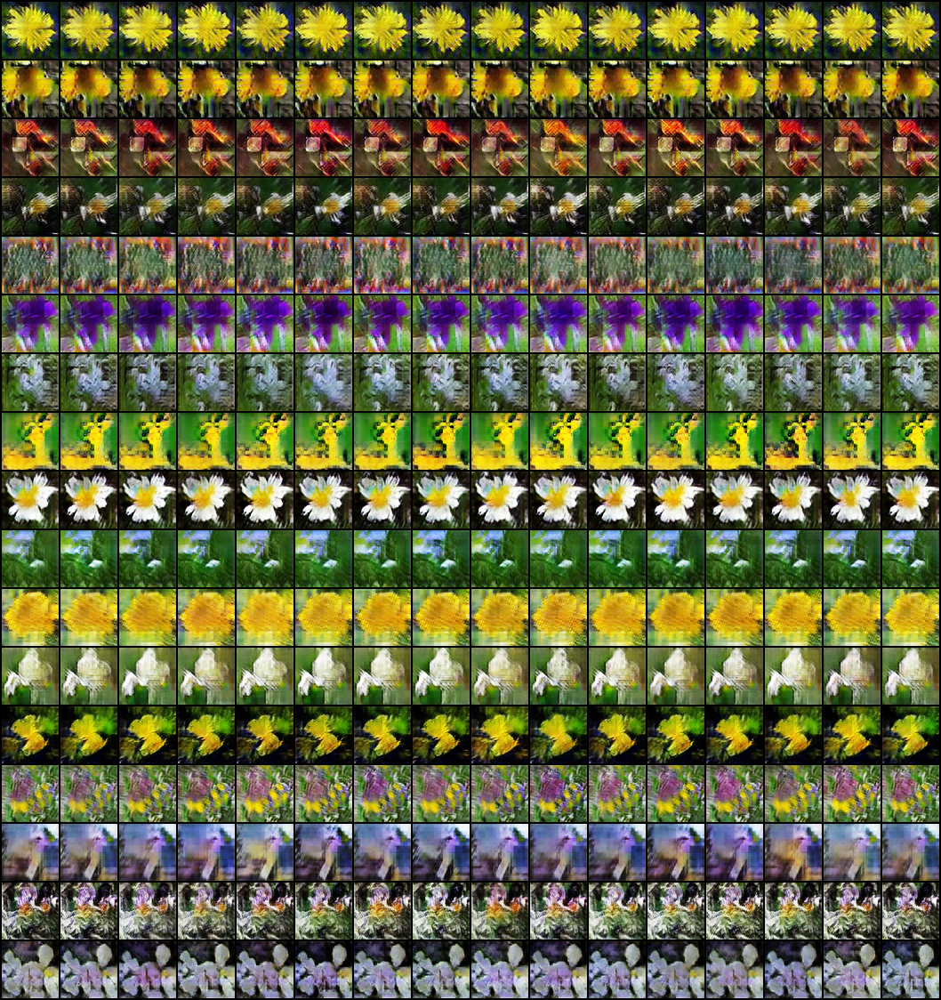

In [47]:
model = GAN(
    loss_type='hinge',
    class_conditional=True,
    truncation_trick=True, 
    data_path='datasets/flowers-17')
load_checkpoint(model, 'hinge_class-cond')

fid, inception_score = calc_eval_metrics(model.eval().cuda(), 'cuda' if use_gpu else 'cpu')

print(f'FID: {fid:.2f}, IS: {inception_score:.2f}')

visualize_image_grid(model)

## Part 3. Report

In this part, you will need to analyze and compare the quality and performance of the trained models. Like in part 1 of this homework, save the images and plots as files in the `report` folder, and provide the answers with illustrations in a separate PDF file.

### Task 1.

Compare the performance of two evaluated GAN losses both qualitatively (comparing generated images side-by-side) and quantitatively (via metrics). What objective leads to the best results?

### Task 2.
Compare (qualitatively and quantitatively) class conditional and non-class conditional models. Which one has better quality and metrics? Reflect and propose an explanation, why is that so?

### Task 3.
Do the same comparison with and without truncation trick. Explain, what changes when this trick is applied, how it affects the results and their quality? Try to explain, why exactly truncation trick works this way?